In [1]:
import json

from bikebench.benchmarking.public_benchmarking_utils import ScoreReportDashboard

c:\Users\Lyler\mambaforge\envs\bike-bench-cuda\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
def verify_conditional_scores(filepaths):
    for filepath in filepaths:
        fullpath = filepath + "/main_scores.json"
        with open(fullpath, 'r') as f:
            main_scores = json.load(f)
        if main_scores["Conditional?"] == False:
            print(f"File {filepath} is not marked as conditional.")

def verify_evaluation_counts(filepaths, expected_count=1e6):
    for filepath in filepaths:
        fullpath = filepath + "/main_scores.json"
        with open(fullpath, 'r') as f:
            main_scores = json.load(f)
        actual_count = main_scores["Evaluation Count"]
        if actual_count > expected_count:
            print(f"File {filepath} has {actual_count} evaluations, expected {expected_count}.")

def verify_masked_constraints(filepaths):
    for filepath in filepaths:
        fullpath = filepath + "/main_scores.json"
        with open(fullpath, 'r') as f:
            main_scores = json.load(f)
        if main_scores["Masked Constraints?"] == False:
            print(f"File {filepath} is not marked as using masked constraints.")

def generate_main_score_table(filepaths, only_main= True):
    all_scores = []
    all_names = []
    for key in filepaths.keys():
        filepath = filepaths[key]
        fullpath = filepath + "/main_scores.json"
        with open(fullpath, 'r') as f:
            main_scores = json.load(f)
        all_scores.append(main_scores)
        all_names.append(key)
    import pandas as pd
    df = pd.DataFrame(all_scores, index=all_names)

    if only_main:
        main_metrics = [
            "Design Quality ↑ (HV)",
            "Constraint Violation ↓",
            "Sim. to Data ↓ (MMD)",
            "Diversity ↓ (DPP)",
        ]
        df = df[main_metrics]
    return df

import re
import pandas as pd

# helper: classify model name into a class
def _classify_model(name: str) -> str:
    n = name.lower()
    if any(x in n for x in ["dataset", "data subset", "baseline"]):
        return "Baseline"
    if "gpt" in n or "llm" in n:
        return "LLM"
    if any(x in n for x in ["ctgan", "tvae"]):
        return "Tabular-GM"
    if any(x in n for x in ["oa-vae", "oa-gan", "oa-ddpm"]):
        return "OA-GM"
    if any(x in n for x in ["nsga", "grad. descent", "grad descent", "gradient", "epo", "agg"]):
        return "Optimizer"
    return "Unknown"

# helper: detect setting from the key/name
def _detect_setting(name: str) -> str:
    n = name.lower()
    if "cond" in n or "conditional" in n:
        return "Conditional"
    if "uncond" in n or "unconditional" in n:
        return "Unconditional"
    # default if not specified
    return "Unconditional"

def generate_average_score_table(
    filepaths: dict,
    only_main: bool = True,
    exclude_baselines: bool = True,
    return_formatted: bool = True
) -> pd.DataFrame:
    """
    Computes class-wise mean scores per setting (Unconditional/Conditional).
    - Excludes baselines ('dataset', 'data subset') by default.
    - Applies rounding if return_formatted=True.
    """
    # 1) get the per-model table the way you already do
    df = generate_main_score_table(filepaths, only_main=only_main).copy()

    # 2) add inferred Class and Setting from index (your keys)
    idx_names = pd.Index(df.index.astype(str), name="ModelName")
    df.insert(0, "Class", [ _classify_model(n) for n in idx_names ])
    df.insert(1, "Setting", [ _detect_setting(n) for n in idx_names ])

    # 3) optionally drop baselines
    if exclude_baselines:
        df = df[df["Class"] != "Baseline"].copy()

    # 4) group by Class and Setting, take mean
    group_cols = ["Class", "Setting"]
    metrics = [
        "Design Quality ↑ (HV)",
        "Constraint Violation ↓",
        "Sim. to Data ↓ (MMD)",
        "Diversity ↓ (DPP)",
    ]
    # keep only the metrics that exist (robust to column order)
    metrics = [m for m in metrics if m in df.columns]

    avg = (
        df.groupby(group_cols, dropna=False)[metrics]
          .mean(numeric_only=True)
          .reset_index()
          .sort_values(group_cols, kind="stable")
          .set_index(group_cols)
    )

    if not return_formatted:
        return avg

    # 5) formatted (rounded) copy
    fmt = avg.copy()
    if "Design Quality ↑ (HV)" in fmt:
        fmt["Design Quality ↑ (HV)"] = fmt["Design Quality ↑ (HV)"].map(lambda x: f"{x:.4f}")
    if "Constraint Violation ↓" in fmt:
        fmt["Constraint Violation ↓"] = fmt["Constraint Violation ↓"].map(lambda x: f"{x:.3f}")
    if "Sim. to Data ↓ (MMD)" in fmt:
        fmt["Sim. to Data ↓ (MMD)"] = fmt["Sim. to Data ↓ (MMD)"].map(lambda x: f"{x:.3f}")
    if "Diversity ↓ (DPP)" in fmt:
        fmt["Diversity ↓ (DPP)"] = fmt["Diversity ↓ (DPP)"].map(lambda x: f"{x:.2f}")

    return fmt


In [3]:
filepaths_conditional = {
    "Dataset (Conditional)": "results/benchmark_results/baseline_dataset",
    "Data Subset (Conditional)": "results/benchmark_results/baseline_dataset_sample_conditional",
    "GPT-5 high (Conditional)": "results/benchmark_results/gpt5_conditional",
    "CTGAN (Conditional)": "results/benchmark_results/CTGAN_conditional",
    "TVAE (Conditional)": "results/benchmark_results/TVAE_conditional",
    "OA-GAN (Conditional)": "results/benchmark_results/GAN_conditional",
    "OA-VAE (Conditional)": "results/benchmark_results/VAE_conditional",
    "OA-DDPM (Conditional)": "results/benchmark_results/DDPM_conditional",
}
verify_conditional_scores(filepaths_conditional.values())
verify_evaluation_counts(filepaths_conditional.values(), expected_count=1e6)


filepaths_masked = {
    "Dataset (Masked)": "results/benchmark_results/baseline_dataset",
    "Data Subset (Masked)": "results/benchmark_results/baseline_dataset_sample_masked",
    "CTGAN (Masked)": "results/benchmark_results/CTGAN_masked",
    "TVAE (Masked)": "results/benchmark_results/TVAE_masked",
    "OA-GAN (Masked)": "results/benchmark_results/GAN_masked",
    "OA-VAE (Masked)": "results/benchmark_results/VAE_masked",
    "OA-DDPM (Masked)": "results/benchmark_results/DDPM_masked",
    "Grad. Descent (Masked)": "results/benchmark_results/GD_masked",
    "NSGA-II (Masked)": "results/benchmark_results/GA_masked",
}
verify_evaluation_counts(filepaths_masked.values(), expected_count=1e6)
verify_masked_constraints(filepaths_masked.values())

filepaths_unconditional = {
    "Dataset (Uncond.)": "results/benchmark_results/baseline_dataset",
    "Data Subset (Uncond.)": "results/benchmark_results/baseline_dataset_sample",
    "GPT-5 high (Uncond.)": "results/benchmark_results/gpt5",
    "CTGAN (Uncond.)": "results/benchmark_results/CTGAN",
    "TVAE (Uncond.)": "results/benchmark_results/TVAE",
    "OA-GAN (Uncond.)": "results/benchmark_results/GAN",
    "OA-VAE (Uncond.)": "results/benchmark_results/VAE",
    "OA-DDPM (Uncond.)": "results/benchmark_results/DDPM",
    "OA-DDPM Guided (Uncond.)": "results/benchmark_results/DDPM-G",
    "Grad. Descent (Uncond.)": "results/benchmark_results/GD",
    "NSGA-II (Uncond.)": "results/benchmark_results/GA",
}
verify_evaluation_counts(filepaths_unconditional.values(), expected_count=1e6)

filepaths_conditional_masked = {
    "Dataset (Cond. & Masked)": "results/benchmark_results/baseline_dataset",
    "Data Subset (Cond. & Masked)": "results/benchmark_results/baseline_dataset_sample_masked_conditional",
    "CTGAN (Cond. & Masked)": "results/benchmark_results/CTGAN_masked_conditional",
    "TVAE (Cond. & Masked)": "results/benchmark_results/TVAE_masked_conditional",
    "OA-GAN (Cond. & Masked)": "results/benchmark_results/GAN_masked_conditional",
    "OA-VAE (Cond. & Masked)": "results/benchmark_results/VAE_masked_conditional",
    "OA-DDPM (Cond. & Masked)": "results/benchmark_results/DDPM_masked_conditional",}

verify_conditional_scores(filepaths_conditional_masked.values())
verify_evaluation_counts(filepaths_conditional_masked.values(), expected_count=1e6)
verify_masked_constraints(filepaths_conditional_masked.values())

display(generate_main_score_table(filepaths_conditional))
display(generate_main_score_table(filepaths_unconditional))
display(generate_main_score_table(filepaths_masked)) 
display(generate_main_score_table(filepaths_conditional_masked))

display(generate_average_score_table(filepaths_conditional))
display(generate_average_score_table(filepaths_unconditional))
display(generate_average_score_table(filepaths_masked))
display(generate_average_score_table(filepaths_conditional_masked))

,Design Quality ↑ (HV),Constraint Violation ↓,Sim. to Data ↓ (MMD),Diversity ↓ (DPP)
Dataset (Conditional),0.003457,2.6988,0.005056,12.721894
Data Subset (Conditional),0.015144,0.1116,0.078842,12.430545
GPT-5 high (Conditional),0.004908,1.2877,0.631263,14.695558
CTGAN (Conditional),0.014795,0.3180,0.082142,11.927788
TVAE (Conditional),0.016111,0.0530,0.153323,13.550609
OA-GAN (Conditional),0.010863,2.5792,0.078601,14.038518
OA-VAE (Conditional),0.018631,0.0014,0.347595,14.970722
OA-DDPM (Conditional),0.016454,0.0416,0.083784,12.818212


,Design Quality ↑ (HV),Constraint Violation ↓,Sim. to Data ↓ (MMD),Diversity ↓ (DPP)
Dataset (Uncond.),0.003457,2.6988,0.005056,12.721894
Data Subset (Uncond.),0.015144,0.0000,0.081416,12.278165
GPT-5 high (Uncond.),0.008572,0.4477,0.363032,14.076287
CTGAN (Uncond.),0.008653,0.0000,0.147113,7.096609
TVAE (Uncond.),0.016016,0.0000,0.163186,13.554192
OA-GAN (Uncond.),0.013662,0.0000,0.307524,14.439462
OA-VAE (Uncond.),0.018111,0.0000,0.300915,14.959956
OA-DDPM (Uncond.),0.016780,0.0000,0.077419,12.554601
OA-DDPM Guided (Uncond.),0.019473,0.0000,0.037419,13.026116
Grad. Descent (Uncond.),0.016416,0.0919,0.265791,12.036111


,Design Quality ↑ (HV),Constraint Violation ↓,Sim. to Data ↓ (MMD),Diversity ↓ (DPP)
Dataset (Masked),0.003457,2.6988,0.005056,12.721894
Data Subset (Masked),0.015144,0.1232,0.081811,12.411793
CTGAN (Masked),0.007924,1.0460,0.123304,9.941080
TVAE (Masked),0.015026,0.6161,0.164055,13.548883
OA-GAN (Masked),0.012770,0.5052,0.195581,14.020433
OA-VAE (Masked),0.014245,0.9713,0.340551,14.994894
OA-DDPM (Masked),0.008696,1.5414,0.100731,11.061859
Grad. Descent (Masked),0.016087,0.6833,0.279004,12.085882
NSGA-II (Masked),0.001054,3.5660,0.606400,11.592835


,Design Quality ↑ (HV),Constraint Violation ↓,Sim. to Data ↓ (MMD),Diversity ↓ (DPP)
Dataset (Cond. & Masked),0.003457,2.6988,0.005056,12.721894
Data Subset (Cond. & Masked),0.015144,0.2157,0.076441,12.510543
CTGAN (Cond. & Masked),0.010917,1.3013,0.098243,11.650462
TVAE (Cond. & Masked),0.015065,0.4279,0.153665,13.542912
OA-GAN (Cond. & Masked),0.011132,2.3898,0.104799,14.119195
OA-VAE (Cond. & Masked),0.015722,1.0615,0.283785,14.921505
OA-DDPM (Cond. & Masked),0.000696,2.4954,0.201463,12.929033


,,Design Quality ↑ (HV),Constraint Violation ↓,Sim. to Data ↓ (MMD),Diversity ↓ (DPP)
Class,Setting,,,,
LLM,Conditional,0.0049,1.288,0.631,14.70
OA-GM,Conditional,0.0153,0.874,0.170,13.94
Tabular-GM,Conditional,0.0155,0.185,0.118,12.74


,,Design Quality ↑ (HV),Constraint Violation ↓,Sim. to Data ↓ (MMD),Diversity ↓ (DPP)
Class,Setting,,,,
LLM,Conditional,0.0086,0.448,0.363,14.08
OA-GM,Conditional,0.0170,0.000,0.181,13.75
Optimizer,Conditional,0.0133,0.046,0.444,11.96
Tabular-GM,Conditional,0.0123,0.000,0.155,10.33


,,Design Quality ↑ (HV),Constraint Violation ↓,Sim. to Data ↓ (MMD),Diversity ↓ (DPP)
Class,Setting,,,,
OA-GM,Unconditional,0.0119,1.006,0.212,13.36
Optimizer,Unconditional,0.0086,2.125,0.443,11.84
Tabular-GM,Unconditional,0.0115,0.831,0.144,11.74


,,Design Quality ↑ (HV),Constraint Violation ↓,Sim. to Data ↓ (MMD),Diversity ↓ (DPP)
Class,Setting,,,,
OA-GM,Conditional,0.0092,1.982,0.197,13.99
Tabular-GM,Conditional,0.0130,0.865,0.126,12.60


C:\Users\Lyler\Documents\Bike-Bench-Internal\src\bikebench\benchmarking\public_benchmarking_utils.py:383: UserWarning: No model_colors provided; using Matplotlib cycle.
  warnings.warn("No model_colors provided; using Matplotlib cycle.")


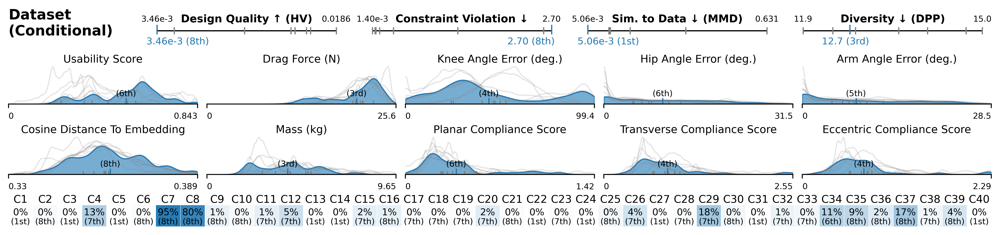

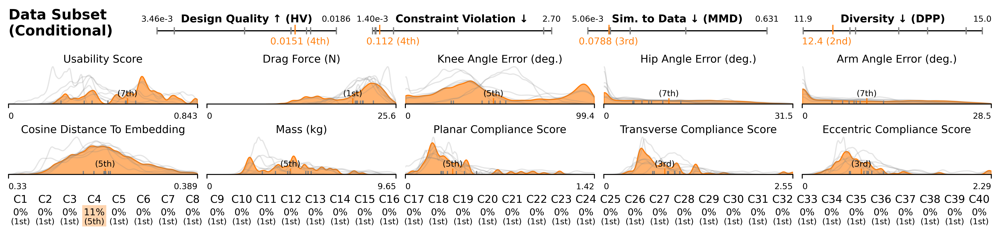

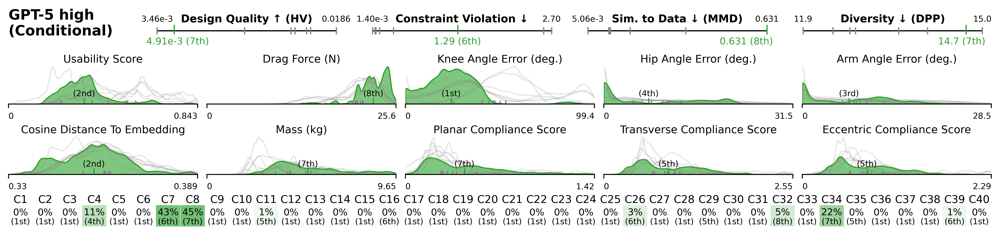

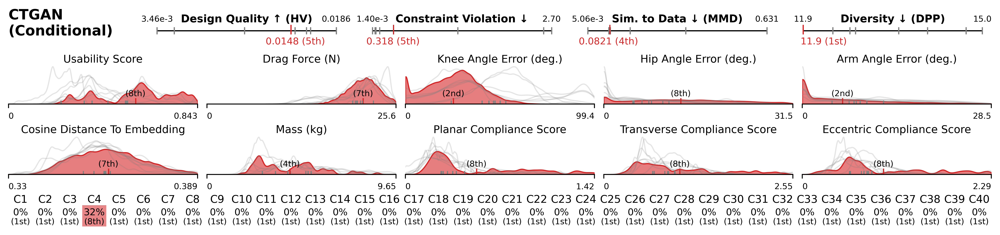

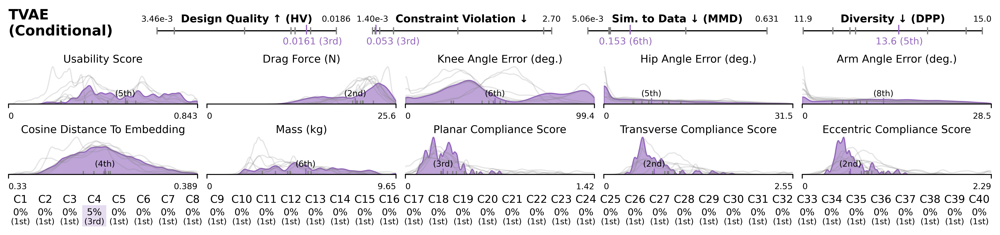

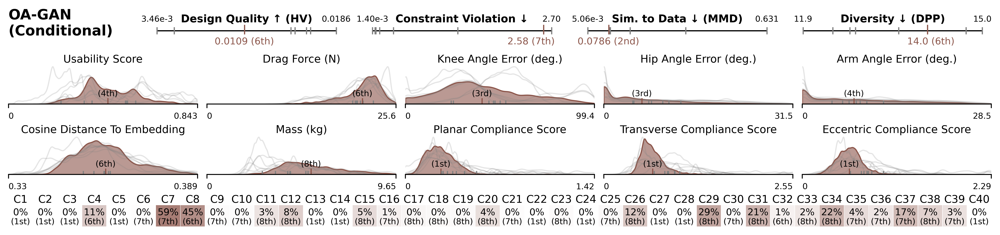

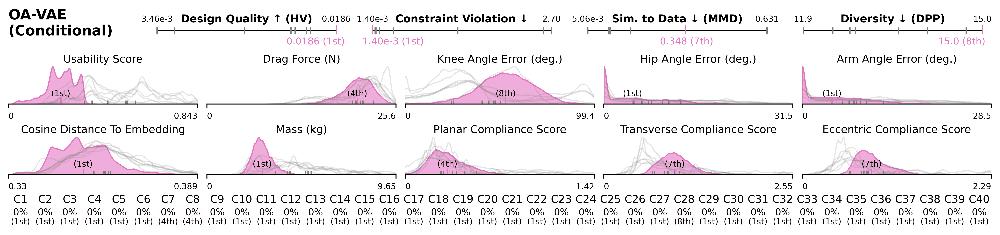

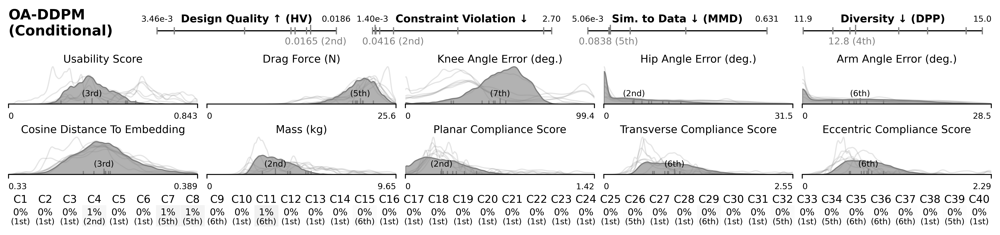

In [4]:
dashboard_conditional = ScoreReportDashboard(
    filepaths = filepaths_conditional,
)
for m in filepaths_conditional.keys():
    dashboard_conditional.show_model(m, save_dir="results/scorecards")

C:\Users\Lyler\Documents\Bike-Bench-Internal\src\bikebench\benchmarking\public_benchmarking_utils.py:383: UserWarning: No model_colors provided; using Matplotlib cycle.
  warnings.warn("No model_colors provided; using Matplotlib cycle.")


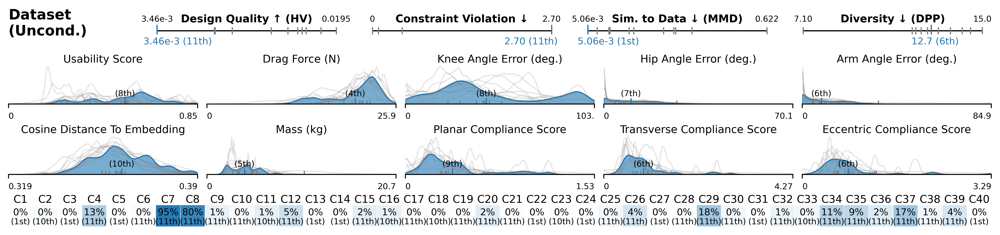

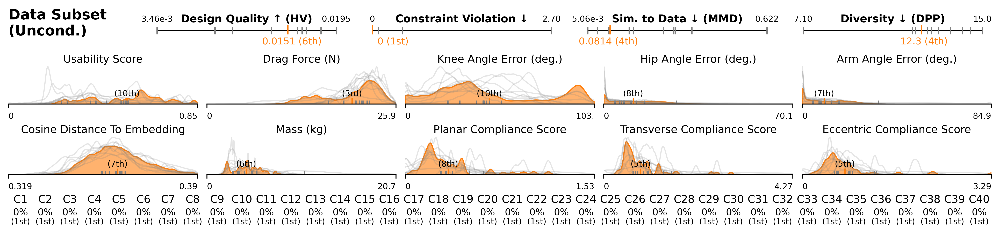

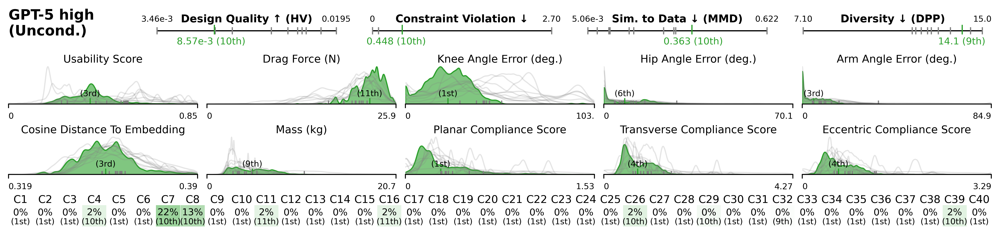

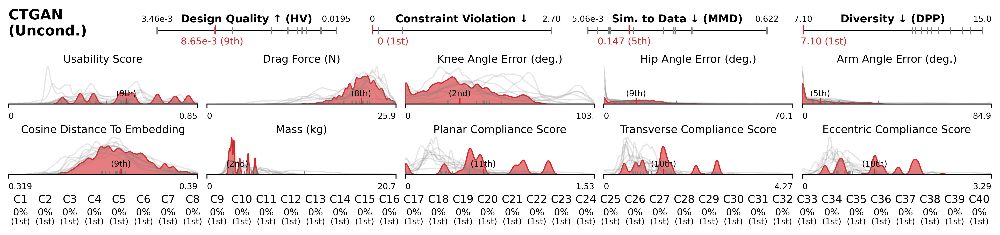

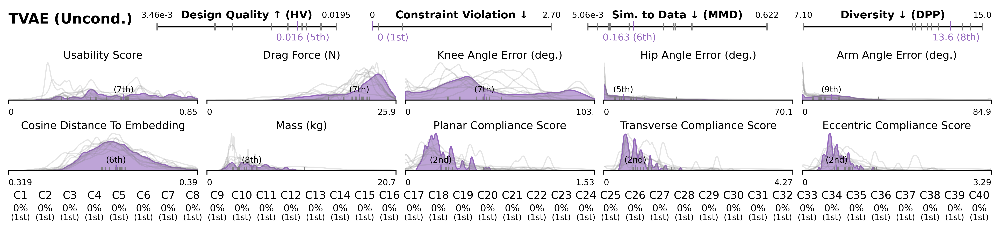

...

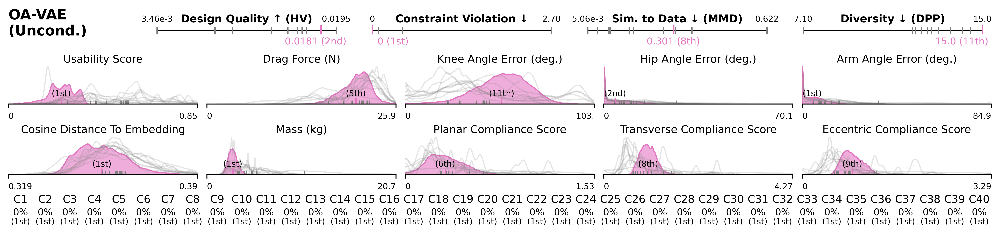

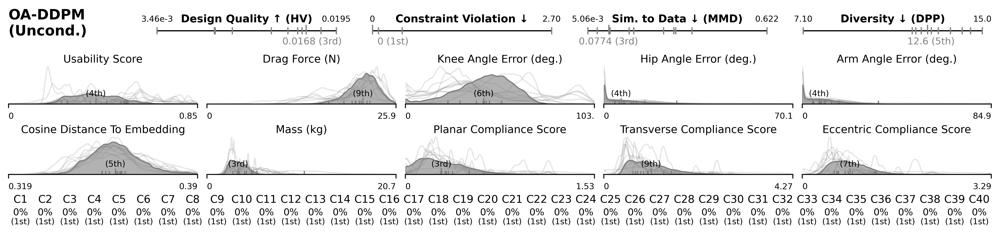

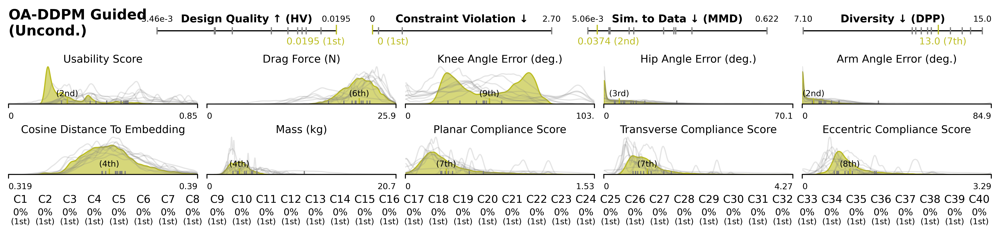

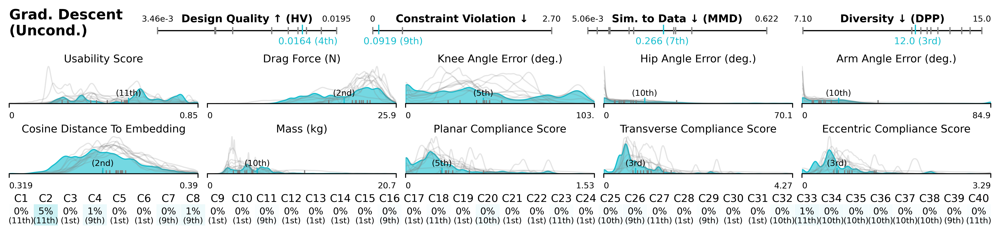

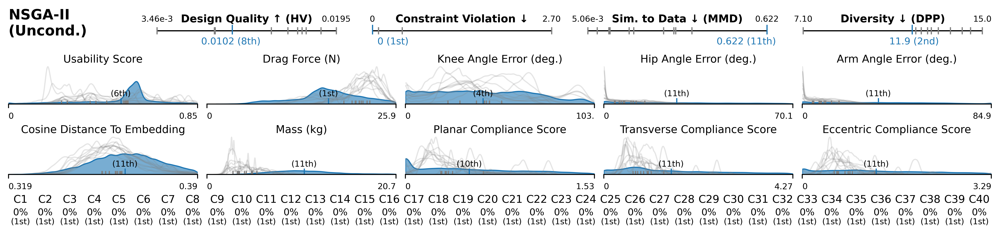

In [5]:
dashboard_unconditional = ScoreReportDashboard(
    filepaths = filepaths_unconditional,
)
for m in filepaths_unconditional.keys():
    dashboard_unconditional.show_model(m, save_dir="results/scorecards")

C:\Users\Lyler\Documents\Bike-Bench-Internal\src\bikebench\benchmarking\public_benchmarking_utils.py:383: UserWarning: No model_colors provided; using Matplotlib cycle.
  warnings.warn("No model_colors provided; using Matplotlib cycle.")


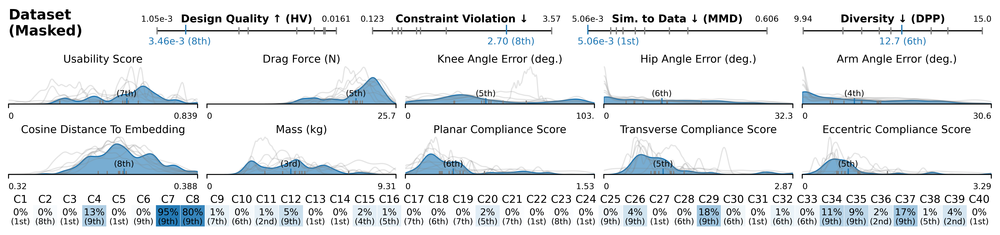

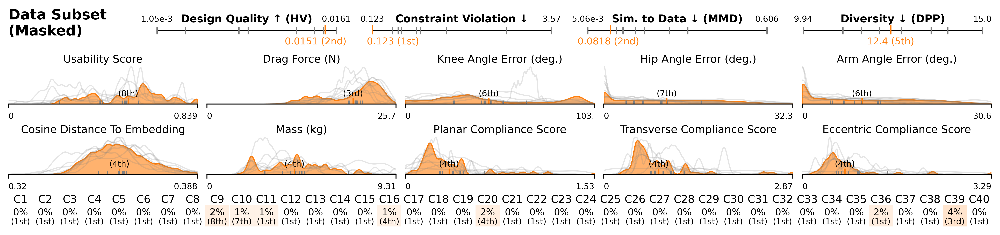

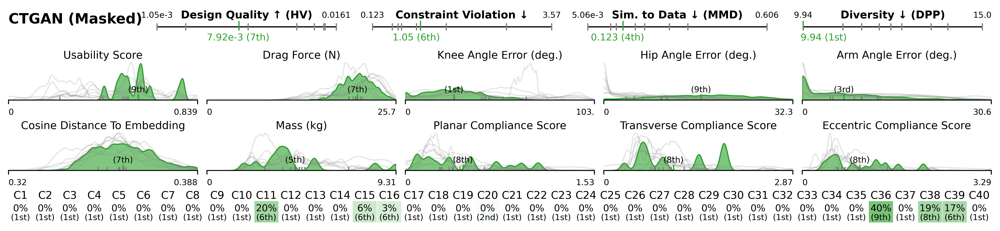

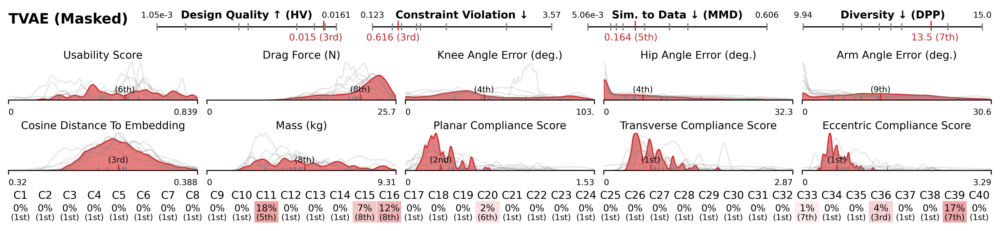

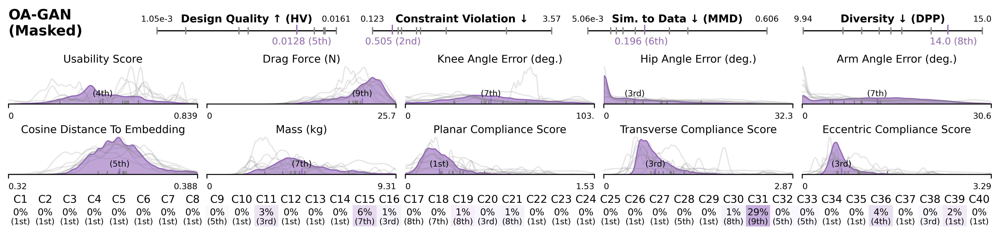

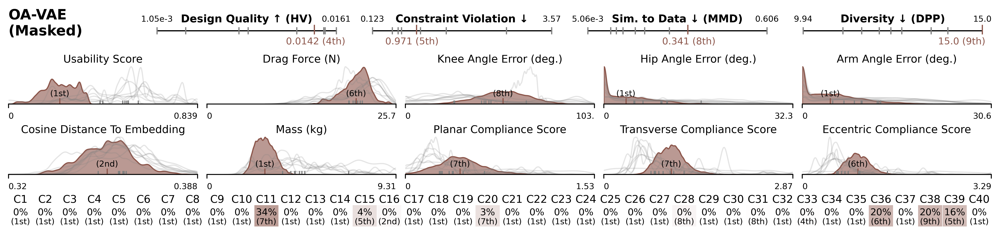

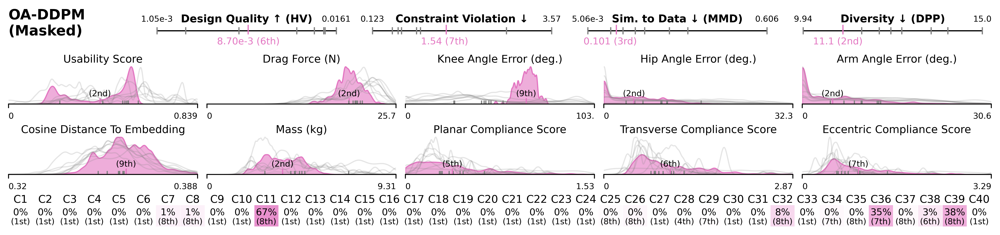

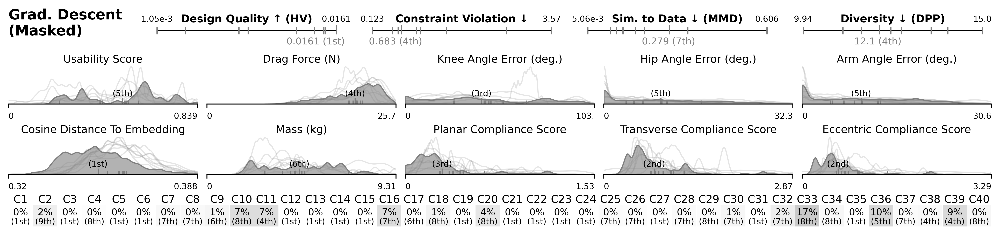

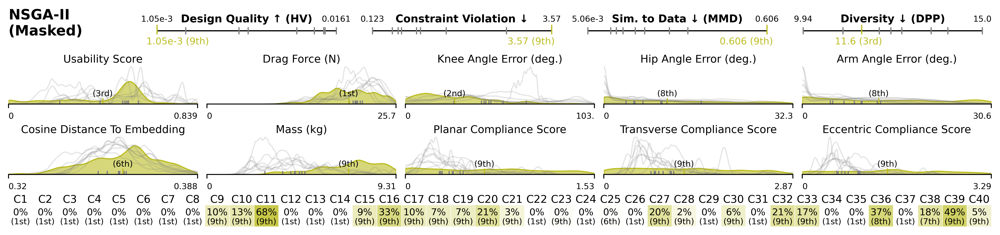

In [6]:
dashboard_masked = ScoreReportDashboard(
    filepaths = filepaths_masked,
)
for m in filepaths_masked.keys():
    dashboard_masked.show_model(m, save_dir="results/scorecards")

C:\Users\Lyler\Documents\Bike-Bench-Internal\src\bikebench\benchmarking\public_benchmarking_utils.py:383: UserWarning: No model_colors provided; using Matplotlib cycle.
  warnings.warn("No model_colors provided; using Matplotlib cycle.")


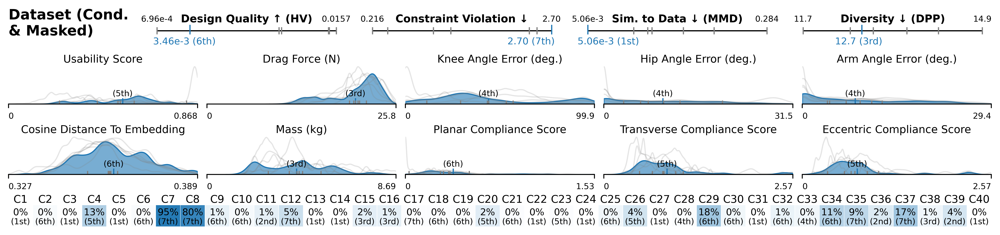

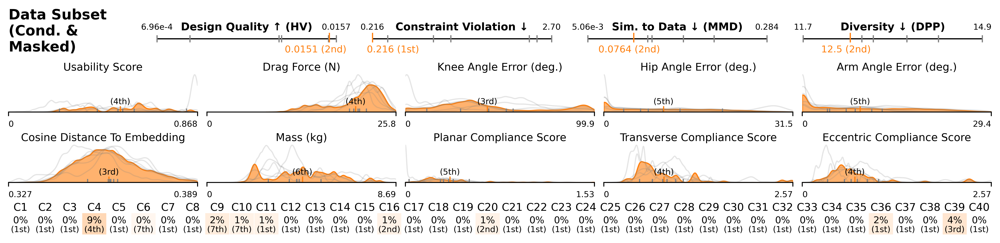

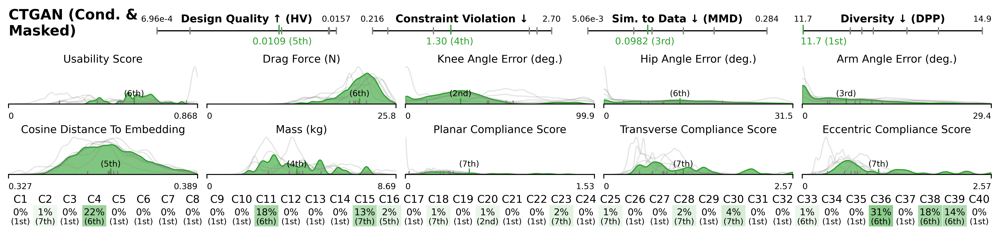

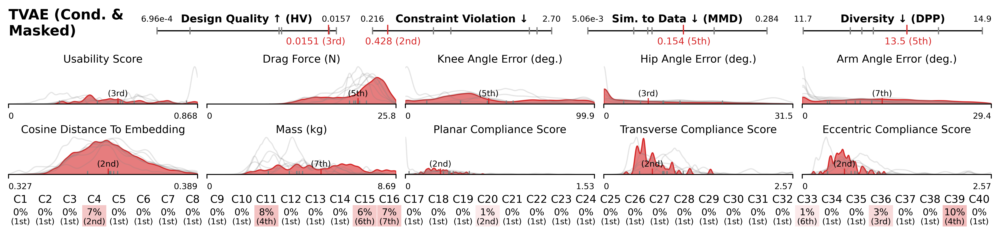

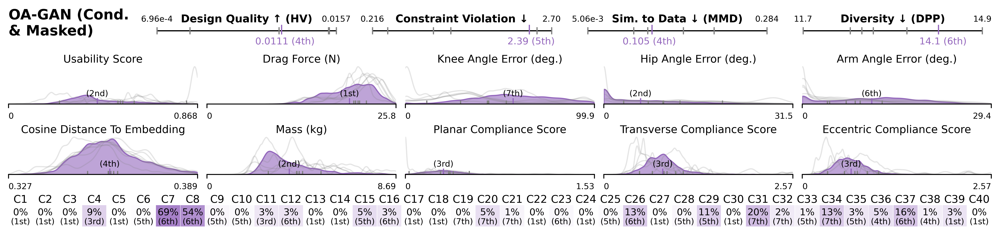

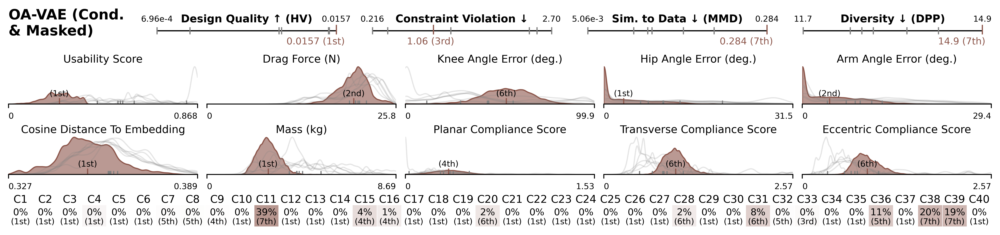

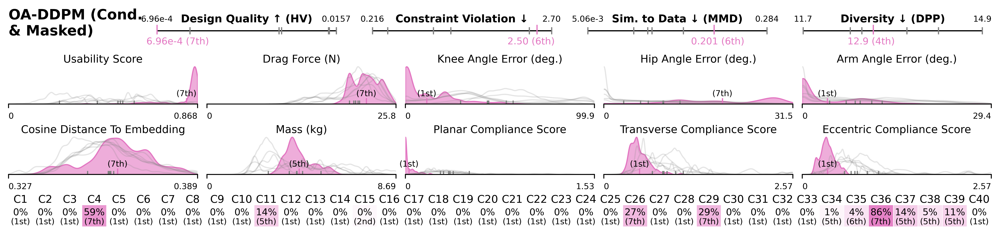

In [7]:
dashboard_conditional_masked = ScoreReportDashboard(
    filepaths = filepaths_conditional_masked,
)
for m in filepaths_conditional_masked.keys():
    dashboard_conditional_masked.show_model(m, save_dir="results/scorecards")